# **Homework 11 - Generative Adversarial Network**

若有任何問題，歡迎來信至助教信箱 ntu-ml-2020spring-ta@googlegroups.com

# Prepare Data


定義我們的 dataset，由於我們之後要使用 torchvision 這個套件來存圖片，因此我們會在這裡將 cv2 讀進來的圖片（BGR）轉成 torchvision 的格式（RGB）。

定義 preprocess: 將 input 形狀 resize 到 (64, 64)，並且將其 value 由 0\~1 線性轉換到 -1~1。

In [1]:
from torch.utils.data import Dataset, DataLoader
import cv2
import os

class FaceDataset(Dataset):
    def __init__(self, fnames, transform):
        self.transform = transform
        self.fnames = fnames
        self.num_samples = len(self.fnames)
    def __getitem__(self,idx):
        fname = self.fnames[idx]
        img = cv2.imread(fname)
        #print(fname, type(img))
        img = self.BGR2RGB(img) #because "torchvision.utils.save_image" use RGB
        img = self.transform(img)
        return img

    def __len__(self):
        return self.num_samples

    def BGR2RGB(self,img):
        return cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

import glob
import torchvision.transforms as transforms

def get_dataset(root):
    fnames = glob.glob(os.path.join(root, '*'))
    # resize the image to (64, 64)
    # linearly map [0, 1] to [-1, 1]
    transform = transforms.Compose(
        [transforms.ToPILImage(),
         transforms.Resize((64, 64)),
         transforms.ToTensor(),
         transforms.Normalize(mean=[0.5] * 3, std=[0.5] * 3) ] )
    dataset = FaceDataset(fnames, transform)
    return dataset

# Some useful functions
這裡我們提供固定 random seed 的函數，以便 reproduce。

In [2]:
import random
import torch
import numpy as np

def same_seeds(seed):
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)  # if you are using multi-GPU.
    np.random.seed(seed)  # Numpy module.
    random.seed(seed)  # Python random module.
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True


# Model
我們使用 DCGAN 作為 baseline mode。圖示為 DCGAN 架構示意圖。圖中的數字僅供參考。
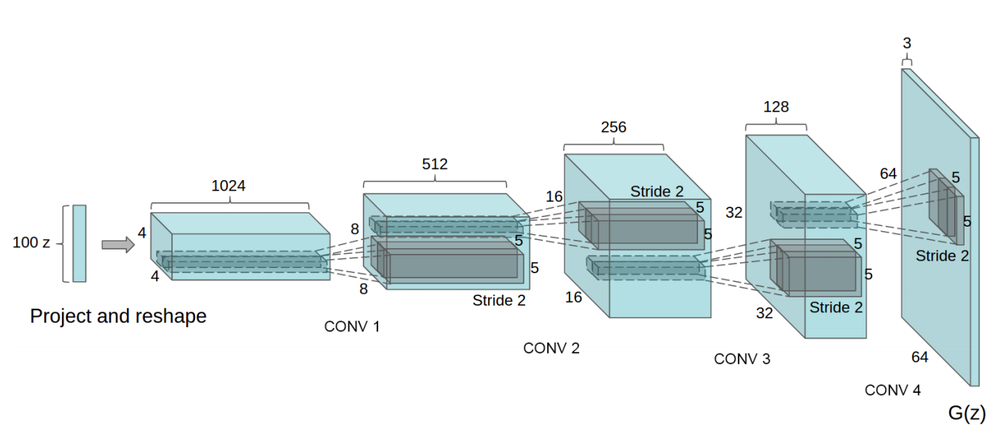

# EBGAN

In [3]:
import torch.nn as nn
import torch.nn.functional as F

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

class Generator(nn.Module):
    """
    input (N, in_dim)
    output (N, 3, 64, 64)
    """
    def __init__(self, in_dim, dim=64):
        super(Generator, self).__init__()
        def dconv_bn_relu(in_dim, out_dim):
            return nn.Sequential(
                nn.ConvTranspose2d(in_dim, out_dim, 5, 2, padding=2, output_padding=1, bias=False),
                nn.BatchNorm2d(out_dim),
                nn.ReLU(True))
        self.l1 = nn.Sequential(
            nn.Linear(in_dim, dim * 8 * 4 * 4, bias=False),
            nn.BatchNorm1d(dim * 8 * 4 * 4),
            nn.ReLU(True))
        self.l2_5 = nn.Sequential(
            dconv_bn_relu(dim * 8, dim * 4),
            dconv_bn_relu(dim * 4, dim * 2),
            dconv_bn_relu(dim * 2, dim),
            nn.ConvTranspose2d(dim, 3, 5, 2, padding=2, output_padding=1),
            nn.Tanh())
        self.apply(weights_init)
    def forward(self, x):
        y = self.l1(x)
        y = y.view(y.size(0), -1, 4, 4)
        y = self.l2_5(y)
        return y

class Discriminator(nn.Module):
    """
    input (N, 3, 64, 64)
    output (N, )
    """
    def __init__(self, in_dim, dim=64):
        super(Discriminator, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(in_dim, 64, 4, 2, 1),
            nn.Dropout(0.35),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(64, 128, 4, 2, 1),
            nn.Dropout(0.35),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(128, 256, 4, 2, 1),
            nn.Dropout(0.35),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, True),
        )
 
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, 4, 2, 1),
            nn.Dropout(0.35),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, True),
            nn.ConvTranspose2d(128, 64, 4, 2, 1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, True),
            nn.ConvTranspose2d(64, in_dim, 4, 2, 1),
            nn.Dropout(0.35),
            nn.BatchNorm2d(3),
            nn.Tanh(),
        )
    
        self.apply(weights_init)        
    def forward(self, x):
        hidden = self.encoder(x)
        out = self.decoder(hidden)
        return out, hidden.view(x.size(0), -1)


In [4]:
def pullaway_loss(embeddings):
    norm = torch.sqrt(torch.sum(embeddings ** 2, -1, keepdim=True)) #取得embedding長度
    normalized_emb = embeddings / norm
    similarity = torch.matmul(normalized_emb, normalized_emb.transpose(1, 0))
    batch_size = embeddings.size(0)
    loss_pt = (torch.sum(similarity) - batch_size) / (batch_size * (batch_size - 1))
    return loss_pt

# Training

設定好 hyperparameters。
準備好 dataloader, model, loss criterion, optimizer。

In [5]:
import torch
from torch import optim
from torch.autograd import Variable
import torchvision

# hyperparameters 
lambda_pt = 1
batch_size = 64
margin = max(1, batch_size / 64.0)
z_dim = 100
lr = 1e-4
n_epoch = 50
save_dir = os.path.join('./', 'logs')
os.makedirs(save_dir, exist_ok=True)

# model
G = Generator(in_dim=z_dim).cuda()
D = Discriminator(3).cuda()
G.train()
D.train()

# loss criterion
#criterion = nn.BCELoss()
criterion = nn.MSELoss()

# optimizer
opt_D = torch.optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))
opt_G = torch.optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))


same_seeds(0)
# dataloader (You might need to edit the dataset path if you use extra dataset.)
dataset = get_dataset( os.path.join('./', 'faces'))
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=0)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


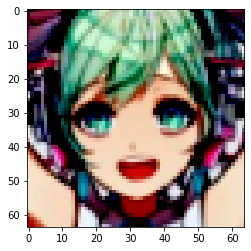

In [6]:
# 隨便印一張圖看看
import matplotlib.pyplot as plt
plt.imshow(dataset[10].numpy().transpose(1,2,0))

接下來就可以開始訓練了。我們定期儲存一些圖片，讓你觀察 Generator 目前的效果。並且定期紀錄 checkpoint。

In [ ]:
# for logging
z_sample = Variable(torch.randn(100, z_dim)).cuda()

for e, epoch in enumerate(range(n_epoch)):
    for i, data in enumerate(dataloader):
        imgs = data
        imgs = imgs.cuda()
        bs = imgs.size(0)
        
        # label        
        r_label = torch.ones((bs)).cuda()
        f_label = torch.zeros((bs)).cuda()
        
        """ train G """
        G.zero_grad()
        # leaf
        z = Variable(torch.randn(bs, z_dim)).cuda()
        f_imgs = G(z)

        # dis
        recon_imgs, g_embeddings = D(f_imgs)        
        
        # compute loss
        loss_G = criterion(recon_imgs, f_imgs.detach()) + lambda_pt * pullaway_loss(g_embeddings)

        # update model
        loss_G.backward()
        opt_G.step()
        
        """ Train D """
        D.zero_grad()
        z = Variable(torch.randn(bs, z_dim)).cuda()
        r_imgs = Variable(imgs).cuda()
        f_imgs = G(z)

        # dis
        real_recon, _ = D(r_imgs)
        fake_recon, _ = D(f_imgs.detach())

        # compute loss
        d_loss_real = criterion(real_recon, r_imgs)
        d_loss_fake = criterion(fake_recon, f_imgs.detach())

        loss_D = d_loss_real
        if (margin - d_loss_fake.data).item() > 0: #表生成圖片接近真實數據
            loss_D += margin - d_loss_fake

        # update model        
        loss_D.backward()
        opt_D.step()
        
        # log
        print(f'\rEpoch [{epoch+1}/{n_epoch}] {i+1}/{len(dataloader)} Loss_D: {loss_D.item():.4f} Loss_G: {loss_G.item():.4f}', end='')
    G.eval()
    f_imgs_sample = (G(z_sample).data + 1) / 2.0
    filename = os.path.join(save_dir, f'Epoch_{epoch+1:03d}.jpg')
    torchvision.utils.save_image(f_imgs_sample, filename, nrow=10)
    print(f' | Save some samples to {filename}.')
    # show generated image
    grid_img = torchvision.utils.make_grid(f_imgs_sample.cpu(), nrow=10)
    plt.figure(figsize=(10,10))
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.show()
    G.train()
    if (e+1) % 5 == 0:
        torch.save(G.state_dict(), f'ebgan_g.pth')
        torch.save(D.state_dict(), f'ebgan_d.pth')



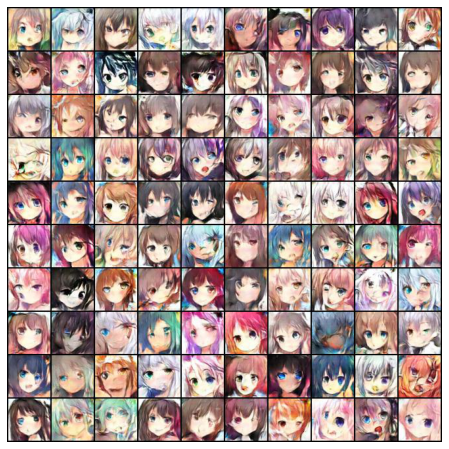

In [4]:
import matplotlib.pyplot as plt
import random
import numpy as np
import matplotlib.animation as animation
from IPython.display import HTML
import imageio
import glob
from PIL import Image

fp_in = "./logs/EBGAN/Epoch_*.jpg"
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(i, animated=True)] for i in imgs]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

# Inference
利用我們訓練好的 Generator 來隨機生成圖片。

In [8]:
import torch
# load pretrained model
G = Generator(z_dim)
G.load_state_dict(torch.load(os.path.join('./', 'ebgan_g.pth')))
G.eval()
G.cuda()

Generator(
  (l1): Sequential(
    (0): Linear(in_features=100, out_features=8192, bias=False)
    (1): BatchNorm1d(8192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (l2_5): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_ru

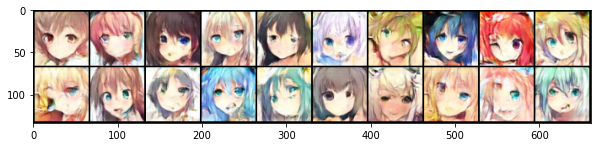

In [11]:
# generate images and save the result
n_output = 20
z_sample = Variable(torch.randn(n_output, z_dim)).cuda()
imgs_sample = (G(z_sample).data + 1) / 2.0
save_dir = os.path.join('./', 'logs')
filename = os.path.join(save_dir, f'result_{epoch}Epochs.jpg')
torchvision.utils.save_image(imgs_sample, filename, nrow=10)
# show image
grid_img = torchvision.utils.make_grid(imgs_sample.cpu(), nrow=10)
plt.figure(figsize=(10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

In [16]:
import imageio
import glob
from PIL import Image
fp_in = "./logs/EBGAN/Epoch_*.jpg"
fp_out = "./logs/EBGAN_image.gif"
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
imageio.mimsave(fp_out,imgs,fps=7)